## LIBRERIAS

In [ ]:
import shutil
import os
import zipfile
import numpy as np
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import tensorflow as tf
from sklearn.metrics import mean_squared_error, mean_absolute_error
import tensorflow as tf
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import MinMaxScaler

In [ ]:
from tensorflow.keras.models import load_model
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Input
from tensorflow.keras.models import Model

## CARGAMOS LA BASE DE DATOS

In [ ]:
file_imagenes='/content/drive/MyDrive/imagenes_comprimidasBASE_KDM.npz'
file_outputs = '/content/drive/MyDrive/outputsBASE_KDM.npz'
MS = np.load(file_imagenes)['data']
outputs = np.load(file_outputs)['data']
print(MS.shape,outputs.shape)

(60000, 224, 224, 3) (60000, 6)


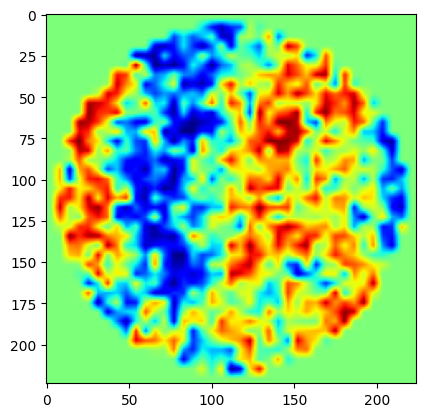

In [ ]:
plt.imshow(MS[700,:,:,0],cmap='jet')

In [ ]:
global_vmin = np.min([np.min(img) for img in MS])
global_vmax = np.max([np.max(img) for img in MS])

## MULTI VARIADO

In [ ]:
# 1. Dividir los datos en entrenamiento, validación y prueba
X_train, X_val, y_train, y_val = train_test_split(MS[:10000], outputs[:10000,:2], test_size=0.1, random_state=42)## COLOCAR EN 10% NUEVAMENTE
del MS, outputs
# 2. Aplicar MinMaxScaler a y_train, y_val, y_test
scaler = MinMaxScaler()
y_train_scaled = scaler.fit_transform(y_train)
y_val_scaled = scaler.transform(y_val)

# 3. Crear `tf.data.Dataset` y dividir en lotes
batch_size = 64

# Función para convertir numpy arrays en Dataset
def create_tf_dataset(X, y):
    dataset = tf.data.Dataset.from_tensor_slices((X, y))
    dataset = dataset.shuffle(len(X)).batch(batch_size).prefetch(tf.data.AUTOTUNE)
    return dataset

# Crear datasets en lotes
train_dataset = create_tf_dataset(X_train, y_train_scaled)
val_dataset = create_tf_dataset(X_val, y_val_scaled)

In [ ]:
del X_train, X_val, y_train, y_val,y_train_scaled,y_val_scaled

In [ ]:
del train_dataset

In [ ]:
from tensorflow.keras.models import load_model
import tensorflow.keras.losses

In [ ]:
# Cargar el modelo con la pérdida explícitamente definida
model_Multivariado = load_model('/content/drive/MyDrive/DoctoradoPaper1/modelo_densenet_regresionjex2BASE_KDM.h5',
                        custom_objects={'mse': tensorflow.keras.losses.MeanSquaredError()})
# Mostrar resumen del modelo
model_Multivariado.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d      │ (None, 230, 230,  │          0 │ input_layer[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,408 │ zero_padding2d[0… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_1    │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 56, 56,    │          0 │ zero_padding2d_1… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │        256 │ pool1[0][0]       │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_relu │ (None, 56, 56,    │          0 │ conv2_block1_0_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      8,192 │ conv2_block1_0_r… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        512 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,864 │ conv2_block1_1_r… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_concat │ (None, 56, 56,    │          0 │ pool1[0][0],      │
│ (Concatenate)       │ 96)               │            │ conv2_block1_2_c… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_bn   │ (None, 56, 56,    │        384 │ conv2_block1_con… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_relu │ (None, 56, 56,    │          0 │ conv2_block2_0_b… │
│ (Activation)        │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_1_conv │ (None, 56, 56,    │     12,288 │ conv2_block2_0_r

 Total params: 7,039,556 (26.85 MB)

 Trainable params: 6,955,906 (26.53 MB)

 Non-trainable params: 83,648 (326.75 KB)

 Optimizer params: 2 (12.00 B)

2/2 ━━━━━━━━━━━━━━━━━━━━ 14s 44ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━

<ipython-input-10-94cabd1679d6>:30: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[i].legend()


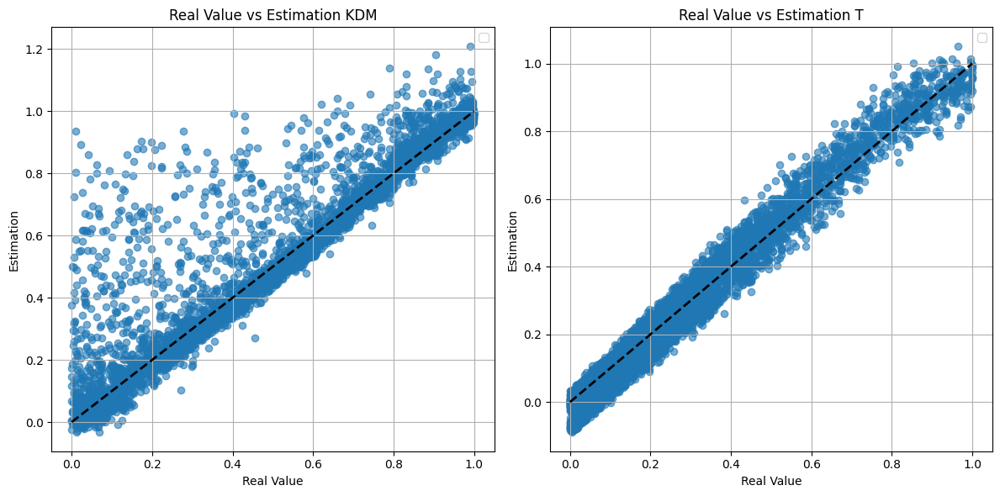

In [ ]:
# Obtener las predicciones del modelo
y_pred_list = []
y_real_list = []

# Iterar sobre val_dataset para extraer datos y hacer predicciones en lotes
for batch_x, batch_y in val_dataset:
    y_pred_batch = model_Multivariado.predict(batch_x)  # Predicción del modelo
    y_pred_list.append(y_pred_batch)
    y_real_list.append(batch_y.numpy())  # Convertir tensores a numpy

# Convertir listas a arrays
y_pred = np.concatenate(y_pred_list, axis=0)
y_real = np.concatenate(y_real_list, axis=0)

# Graficar cada salida por separado
fig, axes = plt.subplots(1, 2, figsize=(12, 6))  # 2 gráficos lado a lado

dicc = {
    '0':'KDM',
    '1':'T'
}

for i in range(2):  # Para ambas salidas
    axes[i].scatter(y_real[:, i], y_pred[:, i], alpha=0.6)
    axes[i].plot([min(y_real[:, i]), max(y_real[:, i])],
                 [min(y_real[:, i]), max(y_real[:, i])], 'k--', lw=2)
    axes[i].set_title(f'Real Value vs Estimation {dicc[str(i)]}')
    axes[i].set_xlabel('Real Value')
    axes[i].set_ylabel('Estimation')
    axes[i].legend()
    axes[i].grid(True)

plt.tight_layout()
plt.show()

ELIMINAMOS LAS PREDICCIONES CON VALORES DE TEMPERATURA MAYORES A 10 SEGUN LO VISTO EN EL ESPACIO DE KDM VS T  PARA VER SI LA MAYORIA DE ERRORES CORRESPONDE A DICHOS VALORES DE TEMPERATURA

(array([1124.,  999.,  855.,  667.,  418.,  265.,  206.,  174.,  168.,
         124.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

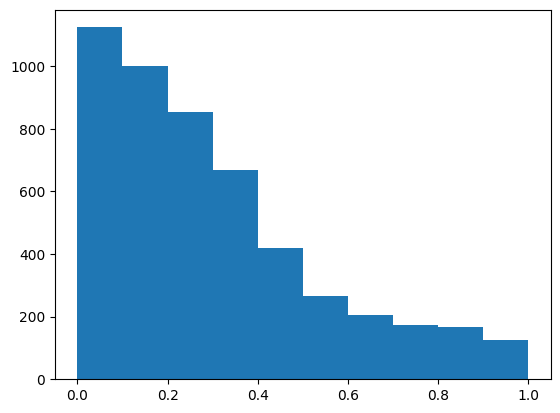

In [ ]:
plt.hist(y_real[:,1])

<ipython-input-13-f87c1b5e877f>:23: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[i].legend()


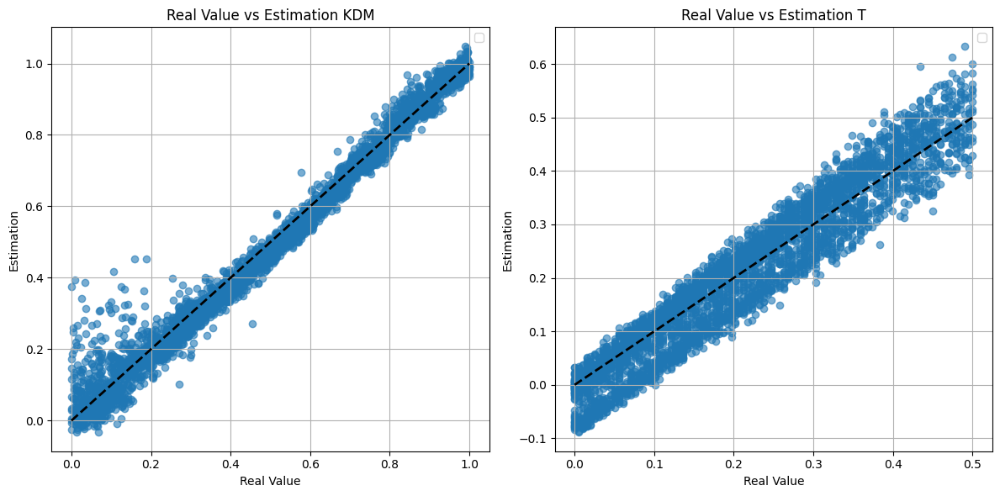

In [ ]:
# Crear una máscara booleana donde la segunda variable (columna 1) es menor a 0.5
mask = y_real[:, 1] < 0.5

# Aplicar la máscara para quedarte solo con esos ejemplos
y_real_filtered = y_real[mask]
y_pred_filtered = y_pred[mask]

# Graficar cada salida por separado
fig, axes = plt.subplots(1, 2, figsize=(12, 6))  # 2 gráficos lado a lado

dicc = {
    '0':'KDM',
    '1':'T'
}

for i in range(2):  # Para ambas salidas
    axes[i].scatter(y_real_filtered[:, i], y_pred_filtered[:, i], alpha=0.6)
    axes[i].plot([min(y_real_filtered[:, i]), max(y_real_filtered[:, i])],
                 [min(y_real_filtered[:, i]), max(y_real_filtered[:, i])], 'k--', lw=2)
    axes[i].set_title(f'Real Value vs Estimation {dicc[str(i)]}')
    axes[i].set_xlabel('Real Value')
    axes[i].set_ylabel('Estimation')
    axes[i].legend()
    axes[i].grid(True)

plt.tight_layout()
plt.show()

In [ ]:
from sklearn.metrics import r2_score
import numpy as np

def masked_mape(y_true, y_pred, epsilon=1e-8):
    """ MAPE con enmascaramiento para valores cercanos a cero """
    mask = np.abs(y_true) > epsilon  # Evitar dividir por valores cercanos a 0
    return np.mean(np.abs((y_true[mask] - y_pred[mask]) / y_true[mask])) * 100

def smape(y_true, y_pred, epsilon=1e-8):
    """ SMAPE con enmascaramiento para valores cercanos a cero """
    denominator = np.abs(y_true) + np.abs(y_pred) + epsilon  # Evitar divisiones por 0
    return np.mean(2 * np.abs(y_true - y_pred) / denominator) * 100

# Calcular métricas por cada salida del modelo
for i in range(y_real_filtered.shape[1]):  # Si hay 2 salidas, se hace para cada una
    r2 = r2_score(y_real_filtered[:, i], y_pred_filtered[:, i])
    mape_value = masked_mape(y_real_filtered[:, i], y_pred_filtered[:, i])
    smape_value = smape(y_real_filtered[:, i], y_pred_filtered[:, i])

    print(f"\n📊 **Métricas para la Salida {i+1}**")
    print(f"✅ R² Score: {r2:.4f}")
    print(f"✅ MAPE: {mape_value:.2f}%")
    print(f"✅ SMAPE: {smape_value:.2f}%")


📊 **Métricas para la Salida 1**
✅ R² Score: 0.9792
✅ MAPE: 29.00%
✅ SMAPE: 14.36%

📊 **Métricas para la Salida 2**
✅ R² Score: 0.8918
✅ MAPE: 42.47%
✅ SMAPE: 37.27%


In [ ]:
import umap
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model

# Seleccionar capas específicas
layer_names = ['pool2_conv','conv3_block4_1_conv','conv4_block7_2_conv','conv5_block16_concat']  # Nombres según DenseNet121
selected_layers = [model_Multivariado.get_layer(name).output for name in layer_names]

# Crear modelos intermedios
intermediate_models = [Model(inputs=model_Multivariado.input, outputs=layer) for layer in selected_layers]
y_real_list = []
activations = {name: [] for name in layer_names}  # Diccionario para almacenar activaciones

# Extraer activaciones en lotes
for batch_x, batch_y in val_dataset:
    for name, model in zip(layer_names, intermediate_models):
        activations[name].append(model.predict(batch_x))  # Guardar salida
    y_real_list.append(batch_y.numpy())  # Guardar valores reales

# Convertir listas a arrays
y_real = np.concatenate(y_real_list, axis=0)
for name in layer_names:
    activations[name] = np.concatenate(activations[name], axis=0)


2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 5s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 11s 42ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
2/2 ━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 10s 10s/step


KDM

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 36ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step


2/2 ━━━━━━━━━━━━━━━━━━━━ 9s 41ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 9s 9s/step


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


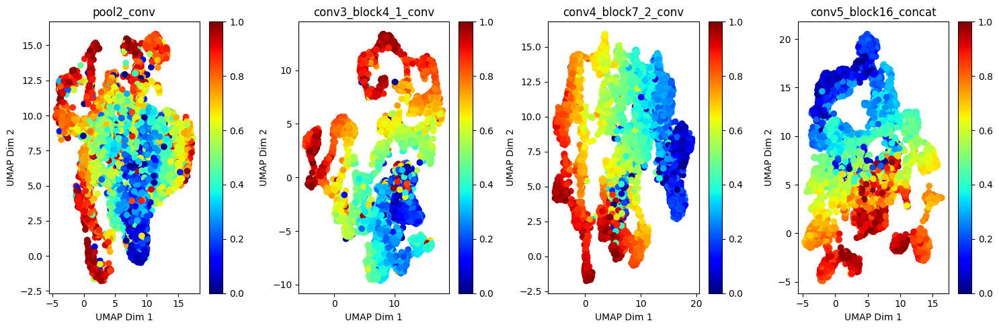

In [ ]:
import umap
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model

# Seleccionar capas específicas
layer_names = ['pool2_conv','conv3_block4_1_conv','conv4_block7_2_conv','conv5_block16_concat']  # Nombres según DenseNet121
selected_layers = [model_Multivariado.get_layer(name).output for name in layer_names]

# Crear modelos intermedios
intermediate_models = [Model(inputs=model_Multivariado.input, outputs=layer) for layer in selected_layers]
y_real_list = []
activations = {name: [] for name in layer_names}  # Diccionario para almacenar activaciones

# Extraer activaciones en lotes
for batch_x, batch_y in val_dataset:
    for name, model in zip(layer_names, intermediate_models):
        activations[name].append(model.predict(batch_x))  # Guardar salida
    y_real_list.append(batch_y.numpy())  # Guardar valores reales

# Convertir listas a arrays
y_real = np.concatenate(y_real_list, axis=0)
for name in layer_names:
    activations[name] = np.concatenate(activations[name], axis=0)



reducer = umap.UMAP(
    n_components=2,
    n_neighbors=5,        # Menos vecinos = más rápido
    min_dist=0.5,         # Mayor separación en el espacio reducido
    metric='cosine',      # Puede ser más eficiente en datos de alta dimensión
    n_epochs=200,         # Reduce número de iteraciones
    low_memory=True
)

plt.figure(figsize=(15, 5))
for i, name in enumerate(layer_names):
    # Reducir dimensionalidad
    activation_2d = reducer.fit_transform(activations[name].reshape(activations[name].shape[0], -1))

    # Graficar
    plt.subplot(1, len(layer_names), i+1)
    plt.scatter(activation_2d[:, 0], activation_2d[:, 1], c=y_real[:, 0],cmap='jet')
    plt.colorbar()
    plt.title(f"{name}")
    plt.xlabel("UMAP Dim 1")
    plt.ylabel("UMAP Dim 2")

plt.tight_layout()
# Guardar como SVG
#plt.savefig("UMAP_visualization_jex2.svg", format="svg", dpi=300)
plt.show()




T

In [ ]:
import umap
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model

In [ ]:
# Seleccionar capas específicas
layer_names = ['pool2_conv','conv3_block4_1_conv','conv4_block7_2_conv','conv5_block16_concat']  # Nombres según DenseNet121
selected_layers = [model_Multivariado.get_layer(name).output for name in layer_names]

In [ ]:
# Crear modelos intermedios
intermediate_models = [Model(inputs=model_Multivariado.input, outputs=layer) for layer in selected_layers]
y_real_list = []
activations = {name: [] for name in layer_names}  # Diccionario para almacenar activaciones

# Extraer activaciones en lotes
for batch_x, batch_y in val_dataset:
    for name, model in zip(layer_names, intermediate_models):
        activations[name].append(model.predict(batch_x))  # Guardar salida
    y_real_list.append(batch_y.numpy())  # Guardar valores reales

# Convertir listas a arrays
y_real = np.concatenate(y_real_list, axis=0)
for name in layer_names:
    activations[name] = np.concatenate(activations[name], axis=0)

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step


2/2 ━━━━━━━━━━━━━━━━━━━━ 4s 33ms/step


2/2 ━━━━━━━━━━━━━━━━━━━━ 10s 42ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


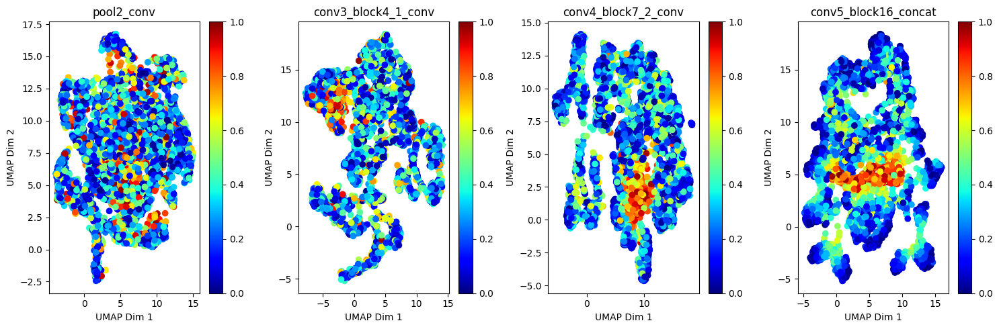

In [ ]:
reducer = umap.UMAP(
    n_components=2,
    n_neighbors=5,        # Menos vecinos = más rápido
    min_dist=0.5,         # Mayor separación en el espacio reducido
    metric='cosine',      # Puede ser más eficiente en datos de alta dimensión
    n_epochs=200,         # Reduce número de iteraciones
    low_memory=True
)

plt.figure(figsize=(15, 5))
for i, name in enumerate(layer_names):
    # Reducir dimensionalidad
    activation_2d = reducer.fit_transform(activations[name].reshape(activations[name].shape[0], -1))

    # Graficar
    plt.subplot(1, len(layer_names), i+1)
    plt.scatter(activation_2d[:, 0], activation_2d[:, 1], c=y_real[:, 1],cmap='jet')
    plt.colorbar()
    plt.title(f"{name}")
    plt.xlabel("UMAP Dim 1")
    plt.ylabel("UMAP Dim 2")

plt.tight_layout()
# Guardar como SVG
#plt.savefig("UMAP_visualization_jex2.svg", format="svg", dpi=300)
plt.show()

## GENERAMOS UMAP VERSION NUEVA

In [ ]:
from tensorflow.keras.models import Model

layer_name = 'conv5_block16_concat'
intermediate_model = Model(inputs=model_Multivariado.input,
                           outputs=model_Multivariado.get_layer(layer_name).output)

activations = []
y_real_list = []
images_raw = []

for batch_x, batch_y in val_dataset:
    activations.append(intermediate_model.predict(batch_x))
    y_real_list.append(batch_y.numpy())
    images_raw.append(batch_x.numpy())

# Convertir a arrays
activations = np.concatenate(activations, axis=0)
y_real = np.concatenate(y_real_list, axis=0)
X_images = np.concatenate(images_raw, axis=0)

2/2 ━━━━━━━━━━━━━━━━━━━━ 14s 46ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━

In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Aplanar activaciones por imagen (una fila por activación)
X_flat = activations.reshape(activations.shape[0], -1)

# Escalado
scaX = MinMaxScaler()
X_scaled = scaX.fit_transform(X_flat)

In [ ]:
from cuml.manifold.umap import UMAP as cuUMAP

cuumap = cuUMAP(n_components=2,
                n_neighbors=500,
                local_connectivity=1,
                random_state=42)

Z = cuumap.fit_transform(X_scaled)  # Output shape: (n_samples, 2)

# Segundo escalado para visualización (opcional)
Z = MinMaxScaler().fit_transform(Z)


[2025-06-03 23:40:57.444] [CUML] [info] build_algo set to brute_force_knn because random_state is given


In [ ]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np

def plot_image_scatter(X, Z, y, th_=0.05, zoom=0.1, xlabel_='', ylabel_=''):
    plt.figure(figsize=(10, 8))
    cmap = plt.cm.jet
    plt.scatter(Z[:, 0], Z[:, 1], c=y, s=30, cmap=cmap, alpha=0.25)

    image_positions = np.array([[1., 1.]])
    for index, position in enumerate(Z):
        dist = np.sum((position - image_positions) ** 2, axis=1)
        if np.min(dist) > th_:
            image_positions = np.r_[image_positions, [position]]
            imagebox = mpl.offsetbox.AnnotationBbox(
                mpl.offsetbox.OffsetImage(X[index][:,:,0], zoom=zoom, cmap="jet"),
                position, frameon=False)
            plt.gca().add_artist(imagebox)

    plt.xlabel(xlabel_)
    plt.ylabel(ylabel_)
    plt.show()


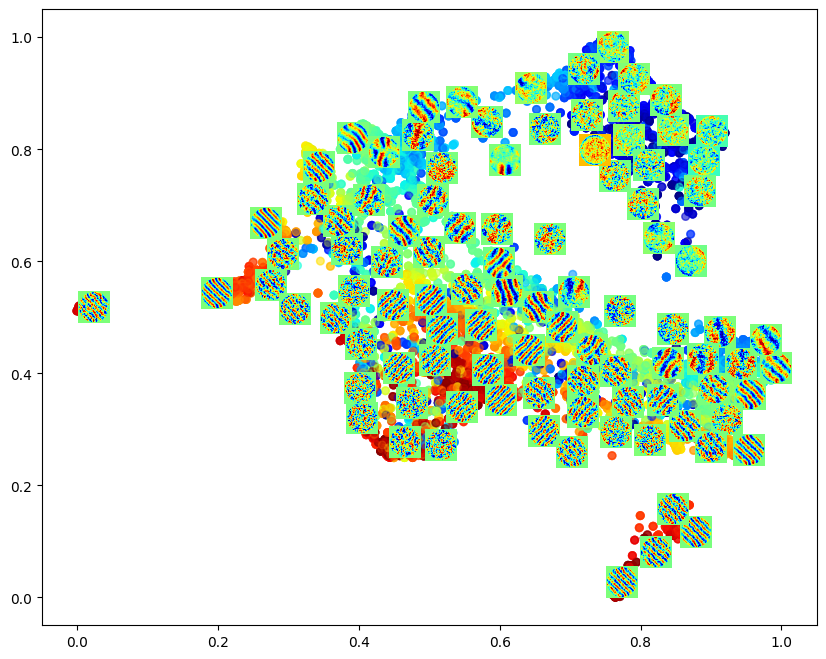

In [ ]:
# Elegir muestra aleatoria
Ns = 50000  # o 80000 si tienes suficiente memoria GPU
ind = np.random.choice(X_images.shape[0], size=Ns)

plot_image_scatter(X_images[ind], Z[ind], y_real[ind, 0], th_=0.0025)


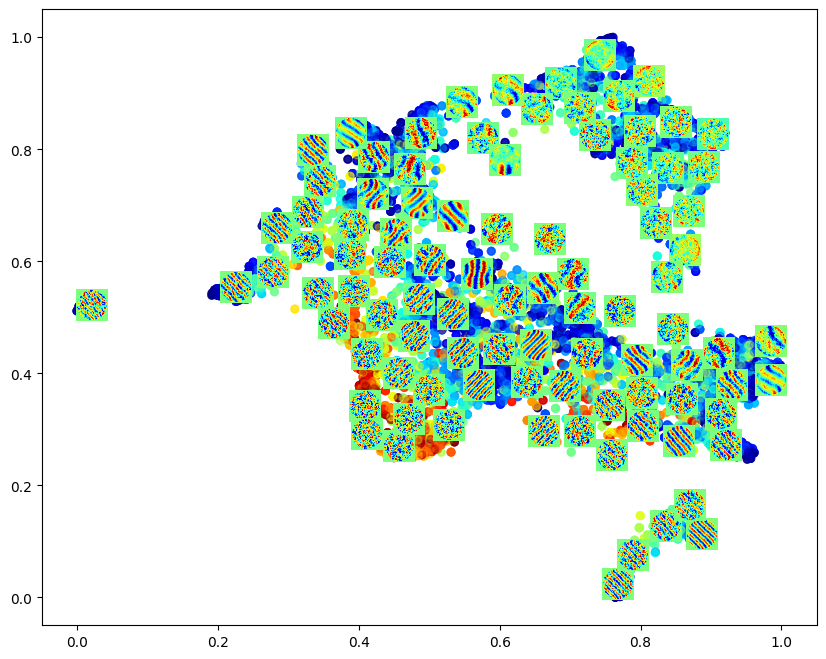

In [ ]:
# Elegir muestra aleatoria
Ns = 50000  # o 80000 si tienes suficiente memoria GPU
ind = np.random.choice(X_images.shape[0], size=Ns)

plot_image_scatter(X_images[ind], Z[ind], y_real[ind, 1], th_=0.0025)

CAMS

Imagenes por cluster

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import umap
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans


Imagenes por rangos en este caso 10 rangos

In [ ]:
# 📌 Extraer todas las imágenes y valores reales del conjunto de validación
images_select = []
real_values_select = []

# Iterar sobre todo el dataset de validación
for X_batch, y_batch in val_dataset:
    for i in range(len(X_batch)):  # Iterar sobre cada muestra en el batch
        images_select.append(X_batch.numpy()[i])  # Guardar imagen
        real_values_select.append(y_batch.numpy()[i,0])  # Guardar el valor real correspondiente


🔹 Rangos definidos automáticamente:
Rango 1: 0.00 - 0.08
Rango 2: 0.08 - 0.17
Rango 3: 0.17 - 0.25
Rango 4: 0.25 - 0.33
Rango 5: 0.33 - 0.42
Rango 6: 0.42 - 0.50
Rango 7: 0.50 - 0.58
Rango 8: 0.58 - 0.66
Rango 9: 0.66 - 0.75
Rango 10: 0.75 - 0.83
Rango 11: 0.83 - 0.91
Rango 12: 0.91 - 1.00


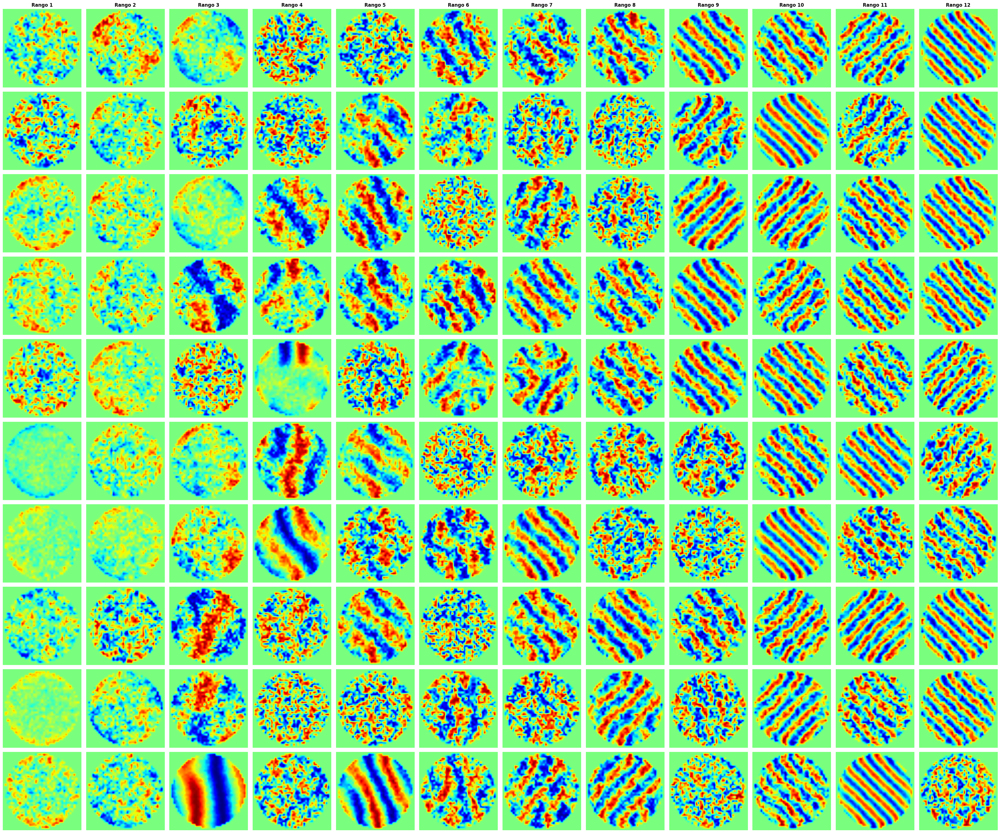

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Convertir a numpy array
real_values_np = np.array(real_values_select)

# Obtener mínimo y máximo de Y
y_min, y_max = real_values_np.min(), real_values_np.max()
N = len(real_values_np)  # Número total de muestras

# Usar la regla de Freedman-Diaconis para calcular el número óptimo de bins
IQR = np.percentile(real_values_np, 75) - np.percentile(real_values_np, 25)  # Rango intercuartil
bin_width = 2 * IQR / (N ** (1 / 3))  # Ancho de bin óptimo
num_bins = max(2, int((y_max - y_min) / bin_width))  # Evitar que num_bins sea menor a 2

# Definir los rangos según la distribución de datos
bins = np.linspace(y_min, y_max, num_bins + 1)  # Crear bins según la cantidad óptima
centros_rango = (bins[:-1] + bins[1:]) / 2  # Centros de cada rango

# Diccionario para almacenar índices por rango
indices_por_rango = {i: [] for i in range(num_bins)}

# Asignar cada muestra a un rango
for i, y in enumerate(real_values_np):
    rango = np.digitize(y, bins) - 1  # Extrae el primer valor del array
    rango = min(rango, num_bins - 1)  # Asegurar que no exceda el índice máximo
    indices_por_rango[int(rango)].append(i)

# Imprimir los valores de los rangos
print("\n🔹 Rangos definidos automáticamente:")
for i in range(num_bins):
    print(f"Rango {i + 1}: {bins[i]:.2f} - {bins[i + 1]:.2f}")

# 🔹 Diccionarios para guardar imágenes y valores seleccionados por cada rango
imagenes_por_rango = {i: [] for i in range(num_bins)}
valores_por_rango = {i: [] for i in range(num_bins)}

# Seleccionar imágenes más representativas de cada rango
for rango, indices in indices_por_rango.items():
    if len(indices) > 0:
        # Ordenar los índices según cercanía al centro del rango
        indices_ordenados = sorted(indices, key=lambda i: abs(float(real_values_select[i]) - centros_rango[rango]))

        # Seleccionar las 10 imágenes más representativas
        seleccion = indices_ordenados[:10]

        # Guardar en los diccionarios separados
        imagenes_por_rango[rango] = [images_select[i] for i in seleccion]
        valores_por_rango[rango] = [real_values_select[i] for i in seleccion]

# 🔹 Graficar las imágenes en una cuadrícula de 10 filas x num_bins columnas
def plot_grid(images_dict, values_dict, num_rows=10, num_cols=num_bins):
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(3 * num_cols, num_rows * 3))

    for i in range(num_cols):  # Columnas → Rangos
        for j in range(num_rows):  # Filas → Muestras
            if j < len(images_dict[i]):  # Verificar que haya imágenes en el rango
                axes[j, i].imshow(images_dict[i][j][:, :, 1], cmap='jet', vmin=global_vmin, vmax=global_vmax)
                axes[j, i].axis("off")

    # Títulos de cada columna (Rango correspondiente)
    for i in range(num_cols):
        axes[0, i].set_title(f"Rango {i + 1}", fontsize=12, fontweight='bold')

    plt.tight_layout()
    plt.show()

# 📌 Mostrar la cuadrícula con 10 muestras por cada rango detectado
plot_grid(imagenes_por_rango, valores_por_rango)



🔹 Rangos definidos en 5 intervalos equidistantes:
Range 1: 0.00 - 0.20
Range 2: 0.20 - 0.40
Range 3: 0.40 - 0.60
Range 4: 0.60 - 0.80
Range 5: 0.80 - 1.00


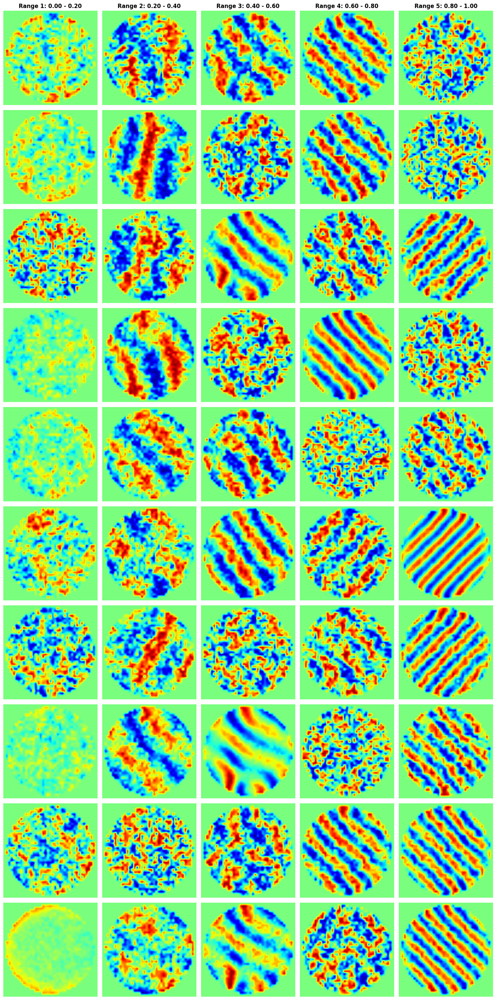

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Convertir a numpy array
real_values_np = np.array(real_values_select)

# Obtener mínimo y máximo de Y
y_min, y_max = real_values_np.min(), real_values_np.max()

# Definir exactamente 5 rangos
num_bins = 5
bins = np.linspace(y_min, y_max, num_bins + 1)  # Crear 6 puntos para 5 rangos
centros_rango = (bins[:-1] + bins[1:]) / 2  # Centros de cada rango

# Diccionario para almacenar índices por rango
indices_por_rango = {i: [] for i in range(num_bins)}

# Asignar cada muestra a un rango
for i, y in enumerate(real_values_np):
    rango = np.digitize(y, bins) - 1  # Ajustar índice de rango
    rango = min(rango, num_bins - 1)  # Asegurar que no exceda el índice máximo
    indices_por_rango[int(rango)].append(i)

# Imprimir los valores de los rangos
print("\n🔹 Rangos definidos en 5 intervalos equidistantes:")
for i in range(num_bins):
    print(f"Range {i + 1}: {bins[i]:.2f} - {bins[i + 1]:.2f}")

# 🔹 Diccionarios para guardar imágenes y valores seleccionados por cada rango
imagenes_por_rango = {i: [] for i in range(num_bins)}
valores_por_rango = {i: [] for i in range(num_bins)}

# Seleccionar imágenes más representativas de cada rango
for rango, indices in indices_por_rango.items():
    if len(indices) > 0:
        # Ordenar los índices según cercanía al centro del rango
        indices_ordenados = sorted(indices, key=lambda i: abs(real_values_select[i] - centros_rango[rango]))

        # Seleccionar las 10 imágenes más representativas
        seleccion = indices_ordenados[:10]

        # Guardar en los diccionarios separados
        imagenes_por_rango[rango] = [images_select[i] for i in seleccion]
        valores_por_rango[rango] = [real_values_select[i] for i in seleccion]

# 🔹 Graficar las imágenes en una cuadrícula de 10 filas x 5 columnas
def plot_grid(images_dict, values_dict, num_rows=10, num_cols=num_bins):
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(3 * num_cols, num_rows * 3))

    for i in range(num_cols):  # Columnas → Rangos
        for j in range(num_rows):  # Filas → Muestras
            if j < len(images_dict[i]):  # Verificar que haya imágenes en el rango
                axes[j, i].imshow(images_dict[i][j][:, :, 0], cmap='jet', vmin=global_vmin, vmax=global_vmax)
                axes[j, i].axis("off")

    # Títulos de cada columna (Rango correspondiente)
    for i in range(num_cols):
        axes[0, i].set_title(f"Range {i + 1}: {bins[i]:.2f} - {bins[i + 1]:.2f}", fontsize=12, fontweight='bold')

    plt.tight_layout()
    plt.show()

# 📌 Mostrar la cuadrícula con 10 muestras por cada uno de los 5 rangos
plot_grid(imagenes_por_rango, valores_por_rango)


CAMS SEGMENTADO POR PARA UNO DE LOS RANGOS

In [ ]:
keys_rangos = list(imagenes_por_rango.keys())

In [ ]:
## FUNCIONES CAMS
import tensorflow as tf
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os


In [ ]:
# 📌 Función para calcular Grad-CAM basado en error absoluto
def compute_gradcam_error(img_array, model, layer_name, y_real):
    grad_model = tf.keras.models.Model(
        inputs=model.input,
        outputs=[model.get_layer(layer_name).output, model.output]
    )
    # Convertir y_real a tensor con misma forma que la predicción
    y_real = tf.constant([[y_real_value]], dtype=tf.float32)
    with tf.GradientTape() as tape:
        conv_output, predictions = grad_model(img_array, training=False)
        loss = 1-tf.abs(y_real - predictions[0])  # 📌 Usamos el error absoluto como pérdida

    grads = tape.gradient(loss, conv_output)  # Gradiente con respecto al error
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))  # Promediar por canal

    conv_output = conv_output.numpy()[0]
    pooled_grads = pooled_grads.numpy()

    # Aplicar pesos a los mapas de características
    for i in range(pooled_grads.shape[-1]):
        conv_output[:, :, i] *= pooled_grads[i]

    # Generar el heatmap
    heatmap = np.mean(conv_output, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)  # Normalizar entre 0 y 1

    return heatmap

# 📌 Función para superponer el heatmap sobre la imagen original
def overlay_heatmap(img, heatmap, alpha=0.4):
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = heatmap * alpha + img
    return np.uint8(superimposed_img)


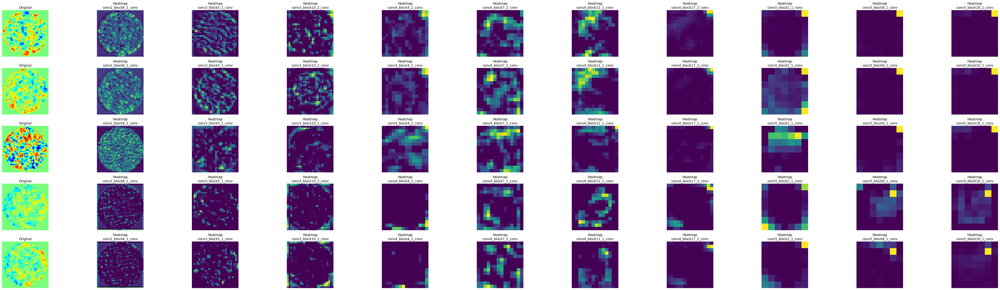

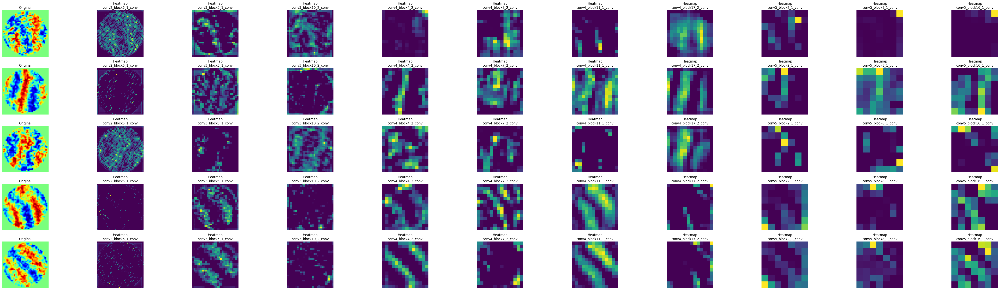

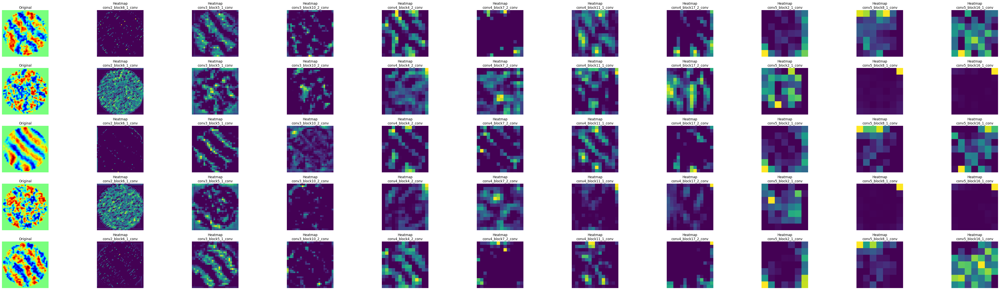

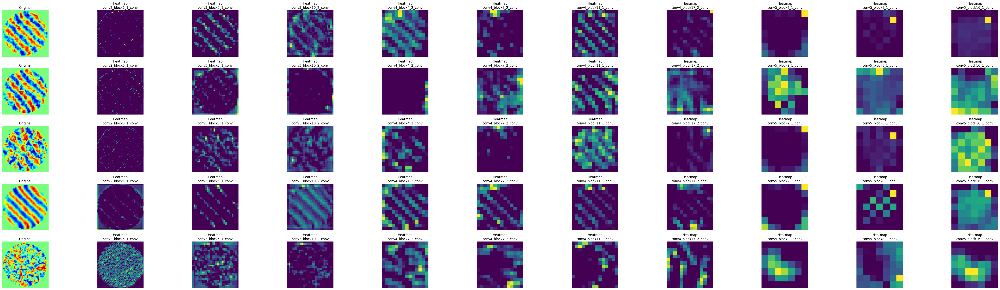

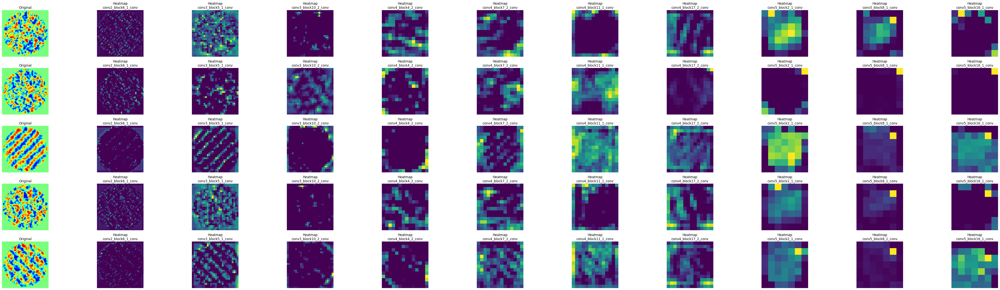

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# 📌 Capas de interés para el Grad-CAM
layer_names = ['conv2_block6_1_conv','conv3_block5_1_conv','conv3_block10_2_conv','conv4_block4_2_conv','conv4_block7_2_conv','conv4_block11_1_conv','conv4_block17_2_conv','conv5_block2_1_conv','conv5_block8_1_conv' , 'conv5_block16_1_conv']
num_layers = len(layer_names)

# 📌 Diccionario para almacenar la contribución promedio de cada capa en cada rango
contribucion_por_rango = {rango: {layer: 0 for layer in layer_names} for rango in imagenes_por_rango.keys()}


# 📌 Generar Grad-CAMs para cada imagen en cada rango y visualizar
for rango, imagenes in imagenes_por_rango.items():
    num_images = len(imagenes)

    if num_images == 0:
        continue  # Saltar si no hay imágenes en el rango

    fig, axes = plt.subplots(5, num_layers + 1, figsize=(5 * (num_layers + 1), 5 * 3))

    for i in range(5):
        img = imagenes[i]
        img_array = np.expand_dims(img, axis=0)
        y_real_value = valores_por_rango[rango][i]

        # 📌 Primera columna: Imagen Original
        axes[i, 0].imshow(img[:, :, 0], cmap='jet', vmin=global_vmin, vmax=global_vmax)
        axes[i, 0].set_title(f"Original")
        axes[i, 0].axis("off")

        for j, layer in enumerate(layer_names):
                heatmap = compute_gradcam_error(img_array, model_Multivariado, layer, y_real_value)
                heatmap = np.maximum(heatmap, 0)  # No permitir valores negativos
                max_heatmap = np.max(heatmap)
                if max_heatmap > 0:
                    heatmap /= max_heatmap  # Normalizar entre 0 y 1
                else:
                    heatmap[:] = 0.0  # O podrías asignar un valor pequeño como 1e-8
                contribucion_por_rango[rango][layer] += np.mean(heatmap)
                # 📌 Mostrar el heatmap
                axes[i, j + 1].imshow(heatmap, cmap='viridis') # Puedes usar otro colormap
                axes[i, j + 1].set_title(f"Heatmap\n{layer}")
                axes[i, j + 1].axis("off")
                # 📌 Agregar una barra de colores en la última imagen de la fila

    plt.tight_layout()
    output_file = f"gradcam_{rango}.svg"
    plt.savefig(output_file, format="svg", bbox_inches="tight")
    plt.show()


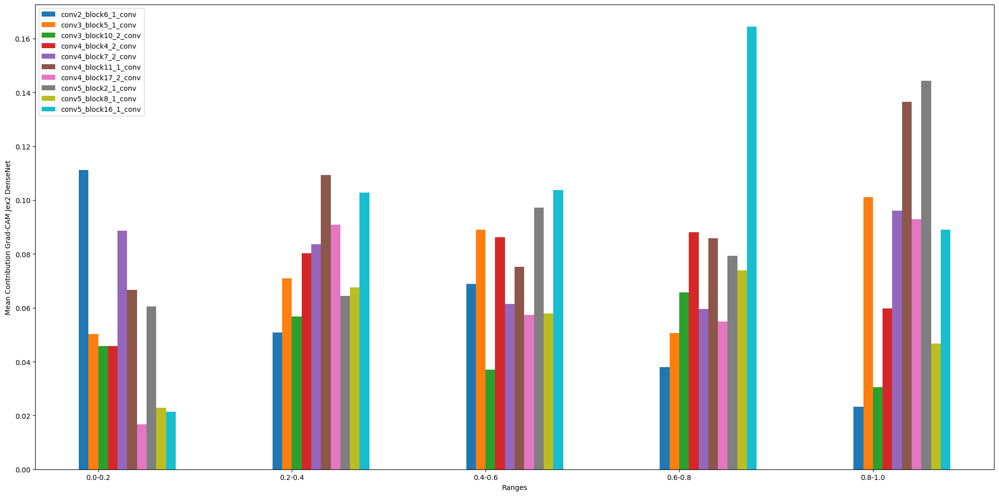

In [ ]:
rangos_labels2=['0.0-0.2', '0.2-0.4', '0.4-0.6', '0.6-0.8', '0.8-1.0']
# 📌 Normalizar la contribución dividiendo por la cantidad de imágenes en cada rango
for rango in contribucion_por_rango.keys():
    num_images = max(1, len(imagenes_por_rango[rango]))  # Evitar división por 0
    for layer in layer_names:
        contribucion_por_rango[rango][layer] /= num_images

# 📊 📌 Generar gráfico de barras con la contribución de cada capa en cada rango
fig, ax = plt.subplots(figsize=(20, 10))
rangos_labels = [f"Rango {r+1}" for r in contribucion_por_rango.keys()]
x = np.arange(len(rangos_labels))

# 📌 Extraer datos por capa
bar_width = 0.05
for i, layer in enumerate(layer_names):
    contribuciones = [contribucion_por_rango[r][layer] for r in contribucion_por_rango.keys()]
    ax.bar(x + i * bar_width, contribuciones, width=bar_width, label=layer)

ax.set_xlabel("Ranges")
ax.set_ylabel("Mean Contribution Grad-CAM Jex2 DenseNet")
ax.set_xticks(x + bar_width * 1.5)
ax.set_xticklabels(rangos_labels2)
ax.legend()

plt.tight_layout()
plt.savefig("mean_contribution_gradcam.svg", format="svg", bbox_inches="tight")
plt.show()

GENERAMOS LOS CAMS  PERO YA CON EL MAPE

In [ ]:
def compute_gradcam_mape(img_array, model, layer_name, y_real, epsilon=1e-6):
    grad_model = tf.keras.models.Model(
        inputs=model.input,
        outputs=[model.get_layer(layer_name).output, model.output]
    )

    y_real = tf.cast(y_real, tf.float32)  # <- ✅ Aseguramos tipo compatible

    with tf.GradientTape() as tape:
        conv_output, predictions = grad_model(img_array, training=False)
        mape = tf.abs((y_real - predictions) / (tf.abs(y_real) + epsilon))
        loss = tf.reduce_mean(mape)

    grads = tape.gradient(loss, conv_output)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    conv_output = conv_output.numpy()[0]
    pooled_grads = pooled_grads.numpy()

    for i in range(pooled_grads.shape[-1]):
        conv_output[:, :, i] *= pooled_grads[i]

    heatmap = np.mean(conv_output, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap) + 1e-6

    return heatmap

# 📌 Función para superponer el heatmap sobre la imagen original
def overlay_heatmap(img, heatmap, alpha=0.4):
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = heatmap * alpha + img
    return np.uint8(superimposed_img)


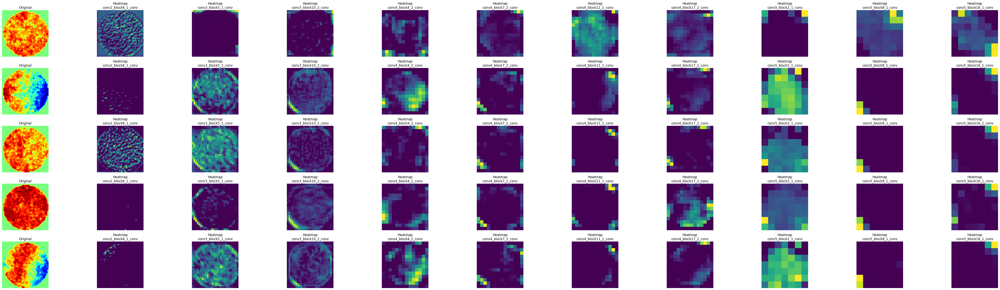

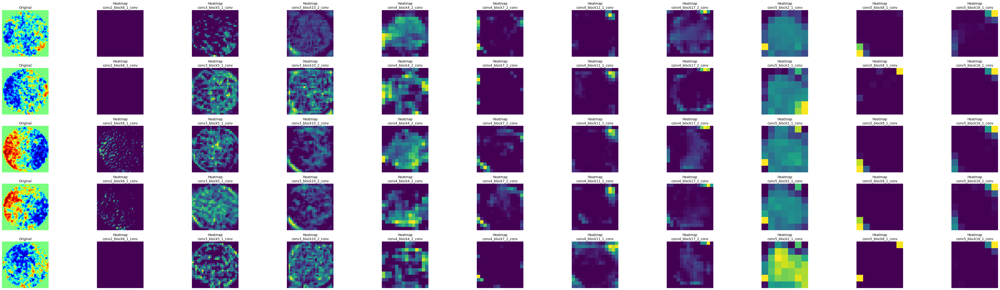

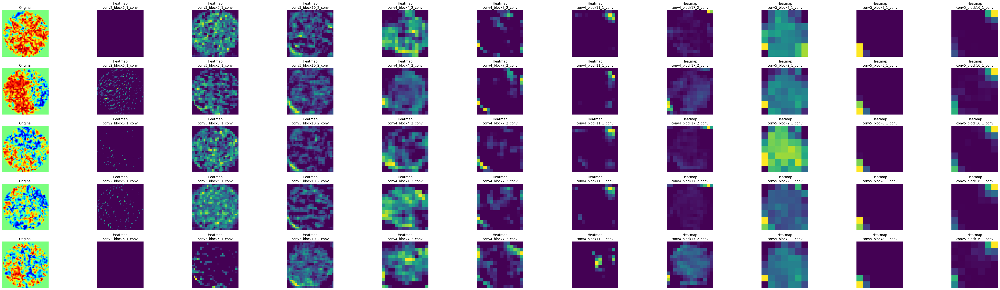

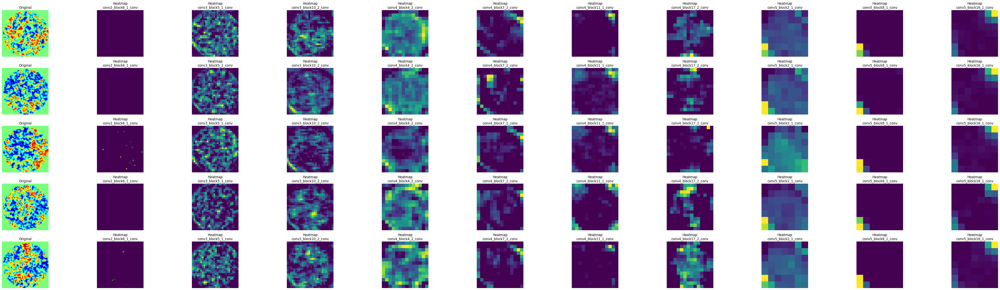

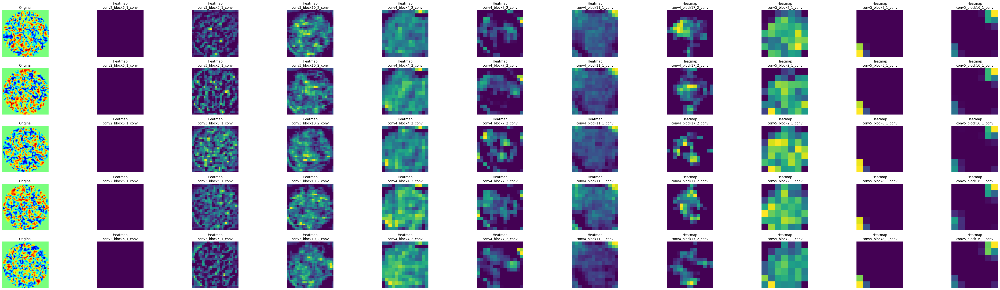

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# 📌 Capas de interés para el Grad-CAM
layer_names = ['conv2_block6_1_conv','conv3_block5_1_conv','conv3_block10_2_conv','conv4_block4_2_conv','conv4_block7_2_conv','conv4_block11_1_conv','conv4_block17_2_conv','conv5_block2_1_conv','conv5_block8_1_conv' , 'conv5_block16_1_conv']
num_layers = len(layer_names)

# 📌 Diccionario para almacenar la contribución promedio de cada capa en cada rango
contribucion_por_rango = {rango: {layer: 0 for layer in layer_names} for rango in imagenes_por_rango.keys()}

# 📌 Generar Grad-CAMs para cada imagen en cada rango y visualizar
for rango, imagenes in imagenes_por_rango.items():
    num_images = len(imagenes)

    if num_images == 0:
        continue  # Saltar si no hay imágenes en el rango

    fig, axes = plt.subplots(5, num_layers + 1, figsize=(5 * (num_layers + 1), 5 * 3))

    for i in range(5):
        img = imagenes[i]
        img_array = np.expand_dims(img, axis=0)
        y_real_value = valores_por_rango[rango][i]

        # 📌 Primera columna: Imagen Original
        axes[i, 0].imshow(img[:, :, 0], cmap='jet', vmin=global_vmin, vmax=global_vmax)
        axes[i, 0].set_title(f"Original")
        axes[i, 0].axis("off")

        for j, layer in enumerate(layer_names):
                heatmap = compute_gradcam_mape(img_array, model_Jex2, layer, y_real_value)
                heatmap = np.maximum(heatmap, 0)  # No permitir valores negativos
                max_heatmap = np.max(heatmap)
                if max_heatmap > 0:
                    heatmap /= max_heatmap  # Normalizar entre 0 y 1
                else:
                    heatmap[:] = 0.0  # O podrías asignar un valor pequeño como 1e-8
                contribucion_por_rango[rango][layer] += np.mean(heatmap)
                # 📌 Mostrar el heatmap
                axes[i, j + 1].imshow(heatmap, cmap='viridis') # Puedes usar otro colormap
                axes[i, j + 1].set_title(f"Heatmap\n{layer}")
                axes[i, j + 1].axis("off")
                # 📌 Agregar una barra de colores en la última imagen de la fila

    plt.tight_layout()
    output_file = f"gradcam_mape_{rango}.svg"
    plt.savefig(output_file, format="svg", bbox_inches="tight")
    plt.show()


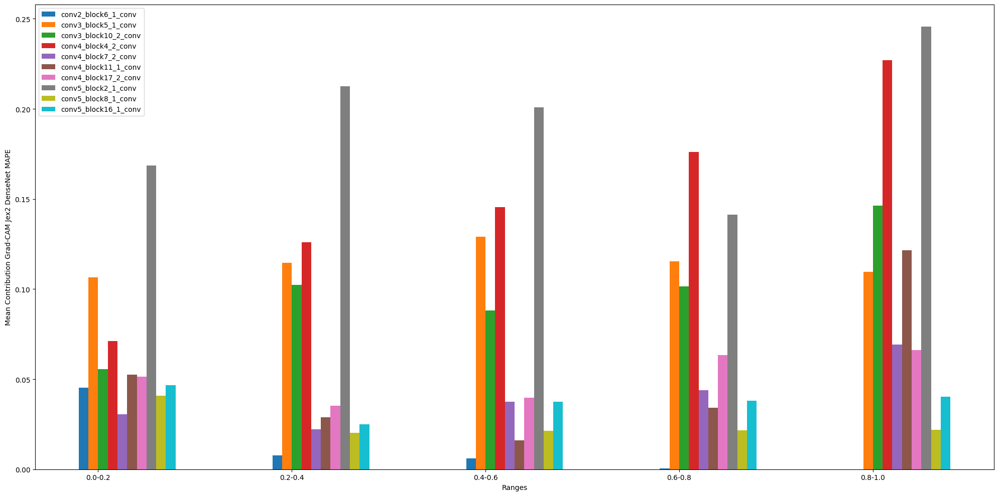

In [ ]:
rangos_labels2=['0.0-0.2', '0.2-0.4', '0.4-0.6', '0.6-0.8', '0.8-1.0']
# 📌 Normalizar la contribución dividiendo por la cantidad de imágenes en cada rango
for rango in contribucion_por_rango.keys():
    num_images = max(1, len(imagenes_por_rango[rango]))  # Evitar división por 0
    for layer in layer_names:
        contribucion_por_rango[rango][layer] /= num_images

# 📊 📌 Generar gráfico de barras con la contribución de cada capa en cada rango
fig, ax = plt.subplots(figsize=(20, 10))
rangos_labels = [f"Rango {r+1}" for r in contribucion_por_rango.keys()]
x = np.arange(len(rangos_labels))

# 📌 Extraer datos por capa
bar_width = 0.05
for i, layer in enumerate(layer_names):
    contribuciones = [contribucion_por_rango[r][layer] for r in contribucion_por_rango.keys()]
    ax.bar(x + i * bar_width, contribuciones, width=bar_width, label=layer)

ax.set_xlabel("Ranges")
ax.set_ylabel("Mean Contribution Grad-CAM Jex2 DenseNet MAPE")
ax.set_xticks(x + bar_width * 1.5)
ax.set_xticklabels(rangos_labels2)
ax.legend()

plt.tight_layout()
plt.savefig("mean_contribution_gradcam_MAPE.svg", format="svg", bbox_inches="tight")
plt.show()

miramos como afecta el enmascaramiento a la predicción

In [ ]:
import tensorflow as tf
import numpy as np

# Asumiendo que ya tienes cargado tu modelo (model_Jex2) y tu conjunto de validación (val_dataset)

def compute_gradcam_mape(img_array, model, layer_name, y_real, epsilon=1e-6):
    grad_model = tf.keras.models.Model(
        inputs=model.input,
        outputs=[model.get_layer(layer_name).output, model.output]
    )

    y_real = tf.cast(y_real, tf.float32)

    with tf.GradientTape() as tape:
        conv_output, predictions = grad_model(img_array, training=False)
        mape = tf.abs((y_real - predictions) / (tf.abs(y_real) + epsilon))
        loss = tf.reduce_mean(mape)

    grads = tape.gradient(loss, conv_output)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    conv_output = conv_output.numpy()[0]
    pooled_grads = pooled_grads.numpy()

    for i in range(pooled_grads.shape[-1]):
        conv_output[:, :, i] *= pooled_grads[i]

    heatmap = np.mean(conv_output, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap) + 1e-6

    return heatmap


# 📌 Función para calcular Grad-CAM basado en error absoluto
def compute_gradcam_error(img_array, model, layer_name, y_real):
    grad_model = tf.keras.models.Model(
        inputs=model.input,
        outputs=[model.get_layer(layer_name).output, model.output]
    )
    # Convertir y_real a tensor con misma forma que la predicción
    y_real = tf.constant([[y_real_value]], dtype=tf.float32)
    with tf.GradientTape() as tape:
        conv_output, predictions = grad_model(img_array, training=False)
        loss = 1-tf.abs(y_real - predictions)  # 📌 Usamos el error absoluto como pérdida

    grads = tape.gradient(loss, conv_output)  # Gradiente con respecto al error
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))  # Promediar por canal

    conv_output = conv_output.numpy()[0]
    pooled_grads = pooled_grads.numpy()

    # Aplicar pesos a los mapas de características
    for i in range(pooled_grads.shape[-1]):
        conv_output[:, :, i] *= pooled_grads[i]

    # Generar el heatmap
    heatmap = np.mean(conv_output, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)  # Normalizar entre 0 y 1

    return heatmap

def create_mask(heatmap, threshold_factor=0.5):
    """Crea una máscara binaria basada en un heatmap."""
    threshold = np.max(heatmap) * threshold_factor
    mask = np.where(heatmap >= threshold, 0, 1).astype(np.float32) # 0 donde el heatmap es alto, 1 donde es bajo
    #mask = np.expand_dims(mask, axis=-1) # Adaptar para multiplicación con la imagen
    return mask

def generate_masked_subset_dataset(model, val_dataset, subset_size=0.5, layer_to_mask='conv4_block7_2_conv', threshold_factor=0.7):
    """Genera un nuevo dataset enmascarado con una parte del val_dataset."""
    masked_images = []
    real_values = []
    original_images = []
    original_real_vals = []

    total_samples = 0
    for _ in val_dataset:
        total_samples += 1
    subset_length = int(total_samples * subset_size)
    count = 0

    for X_batch, y_batch in val_dataset:
        for i in range(len(X_batch)):
            if count < subset_length:
                original_image = X_batch.numpy()[i]
                real_value = y_batch.numpy()[i]
                original_images.append(original_image)
                original_real_vals.append(real_value)
                img_array = np.expand_dims(original_image, axis=0)

                # 1. Generar el mapa de activación basado en el MAPE
                heatmap_mape = compute_gradcam_mape(img_array,model, layer_to_mask, tf.constant([[real_value]], dtype=tf.float32))
                resized_heatmap = tf.image.resize(np.expand_dims(heatmap_mape, axis=-1), original_image.shape[:2]).numpy()
                # 2. Crear la máscara
                mask = create_mask(resized_heatmap, threshold_factor=threshold_factor)

                # 3. Aplicar la máscara a la imagen original
                masked_image = original_image * mask
                masked_images.append(masked_image)
                real_values.append(real_value)

            else:
                break
        if count >= subset_length:
            break
        count += 1


    # Crear nuevos tf.data.Dataset
    masked_dataset = tf.data.Dataset.from_tensor_slices((np.array(masked_images), np.array(real_values))).batch(32)
    original_subset_dataset = tf.data.Dataset.from_tensor_slices((np.array(original_images), np.array(original_real_vals))).batch(32)

    return original_subset_dataset, masked_dataset

In [ ]:
# Elegir la capa para generar los mapas de activación
layer_to_mask = 'conv5_block2_1_conv' # Ejemplo de una de tus capas
threshold_factor = 0.8
subset_percentage = 1 # Usar la mitad del dataset
# Generar el nuevo dataset enmascarado
original_subset_val_dataset, masked_subset_val_dataset = generate_masked_subset_dataset(
    model_Jex2, val_dataset, subset_size=subset_percentage, layer_to_mask=layer_to_mask, threshold_factor=threshold_factor
)


In [ ]:
from sklearn.metrics import r2_score

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━

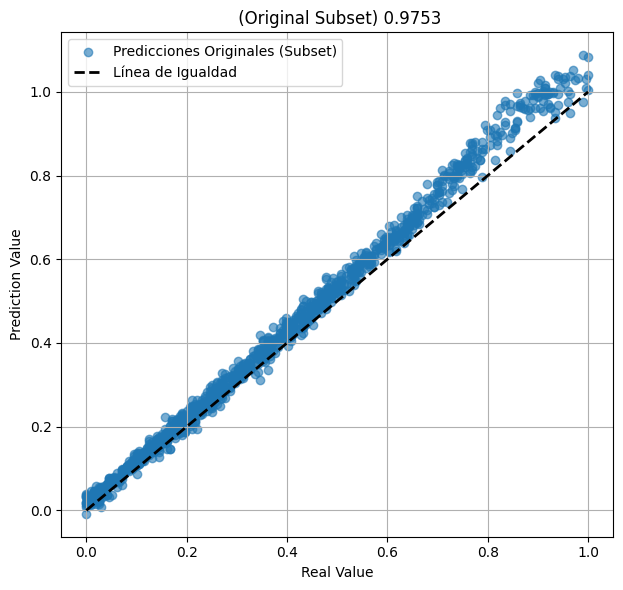

In [ ]:
# --- A partir de aquí, puedes usar tu código existente para realizar las predicciones ---

# --- Realizar predicciones con el subconjunto original ---
y_pred_original_list = []
y_real_original_list = []
for batch_x, batch_y in original_subset_val_dataset:
    y_pred_batch = model_Jex2.predict(batch_x)
    y_pred_original_list.append(y_pred_batch)
    y_real_original_list.append(batch_y.numpy())
y_pred_original = np.concatenate(y_pred_original_list, axis=0)
y_real_original = np.concatenate(y_real_original_list, axis=0)



# --- Evaluar el R2 ---
r2_original = r2_score(y_real_original, y_pred_original)


print(f"R2 con la mitad del dataset original: {r2_original:.4f}")


# --- Graficar las predicciones (opcional) ---
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.scatter(y_real_original[:, 0], y_pred_original[:, 0], alpha=0.6, label="Predicciones Originales (Subset)")
plt.plot([min(y_real_original[:, 0]), max(y_real_original[:, 0])],
         [min(y_real_original[:, 0]), max(y_real_original[:, 0])], 'k--', lw=2, label="Línea de Igualdad")
plt.title(f' (Original Subset) {r2_original:.4f}')
plt.xlabel('Real Value')
plt.ylabel('Prediction Value')
plt.legend()
plt.grid(True)



plt.tight_layout()
plt.show()

In [ ]:
print(f"Shape of batch_x before prediction: {batch_x.shape}") #

Shape of batch_x before prediction: (4, 224, 224, 3)


In [ ]:
batch_y.shape

TensorShape([4, 1])

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━

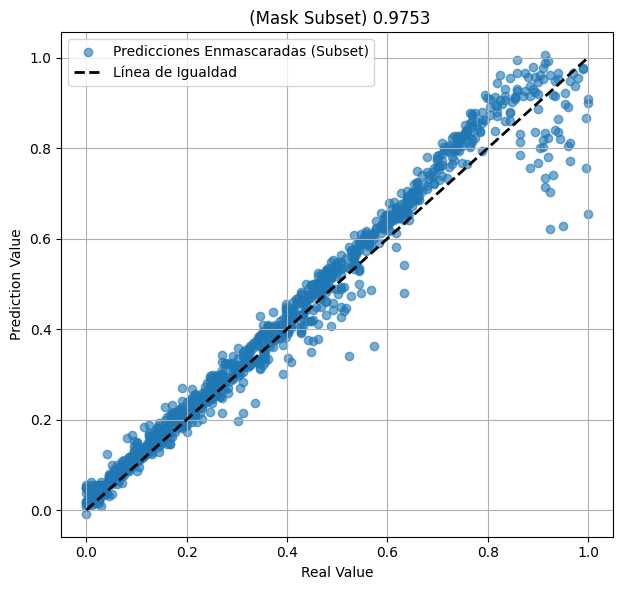

In [ ]:
# --- Realizar predicciones con el subconjunto enmascarado ---
y_pred_masked_list = []
y_real_masked_list = []
for batch_x, batch_y in masked_subset_val_dataset:
    y_pred_batch = model_Jex2.predict(batch_x)
    y_pred_masked_list.append(y_pred_batch)
    y_real_masked_list.append(batch_y.numpy())
y_pred_masked = np.concatenate(y_pred_masked_list, axis=0)
y_real_masked = np.concatenate(y_real_masked_list, axis=0)

r2_masked = r2_score(y_real_masked, y_pred_masked)
print(f"R2 con la mitad del dataset enmascarado: {r2_masked:.4f}")
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.scatter(y_real_masked[:, 0], y_pred_masked[:, 0], alpha=0.6, label="Predicciones Enmascaradas (Subset)")
plt.plot([min(y_real_masked[:, 0]), max(y_real_masked[:, 0])],
         [min(y_real_masked[:, 0]), max(y_real_masked[:, 0])], 'k--', lw=2, label="Línea de Igualdad")
plt.title(f' (Mask Subset) {r2_original:.4f}')
plt.xlabel('Real Value')
plt.ylabel('Prediction Value')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

## T

In [ ]:
# 1. Dividir los datos en entrenamiento, validación y prueba
X_train, X_val, y_train, y_val = train_test_split(MS, T.reshape(-1, 1), test_size=0.1, random_state=42)
del MS
# 2. Aplicar MinMaxScaler a y_train, y_val, y_test
scaler = MinMaxScaler()
y_train_scaled = scaler.fit_transform(y_train)
y_val_scaled = scaler.transform(y_val)

# 3. Crear `tf.data.Dataset` y dividir en lotes
batch_size = 32

# Función para convertir numpy arrays en Dataset
def create_tf_dataset(X, y):
    dataset = tf.data.Dataset.from_tensor_slices((X, y))
    dataset = dataset.shuffle(len(X)).batch(batch_size).prefetch(tf.data.AUTOTUNE)
    return dataset

# Crear datasets en lotes
train_dataset = create_tf_dataset(X_train, y_train_scaled)
val_dataset = create_tf_dataset(X_val, y_val_scaled)

In [ ]:
del X_train, X_val, y_train, y_val,y_train_scaled,y_val_scaled

In [ ]:
from tensorflow.keras.models import load_model
import tensorflow.keras.losses

model_T = load_model('/content/drive/MyDrive/DoctoradoPaper1/modelo_densenet_regresionT.h5',
                        custom_objects={'mse': tensorflow.keras.losses.MeanSquaredError()})
# Mostrar resumen del modelo
model_T.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d            │ (None, 230, 230, 3)    │              0 │ input_layer[0][0]      │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,408 │ zero_padding2d[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 112, 112, 64)   │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 112, 112, 64)   │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_1          │ (None, 114, 114, 64)   │              0 │ conv1_relu[0][0]       │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1 (MaxPooling2D)      │ (None, 56, 56, 64)     │              0 │ zero_padding2d_1[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_bn         │ (None, 56, 56, 64)     │            256 │ pool1[0][0]            │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_0_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 128)    │          8,192 │ conv2_block1_0_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 128)    │            512 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 128)    │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 32)     │         36,864 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_concat       │ (None, 56, 56, 96)     │              0 │ pool1[0][0],           │
│ (Concatenate)             │                        │                │ conv2_block1_2_conv[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block2_0_bn    

 Total params: 7,038,531 (26.85 MB)

 Trainable params: 6,954,881 (26.53 MB)

 Non-trainable params: 83,648 (326.75 KB)

 Optimizer params: 2 (12.00 B)

2/2 ━━━━━━━━━━━━━━━━━━━━ 13s 42ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━

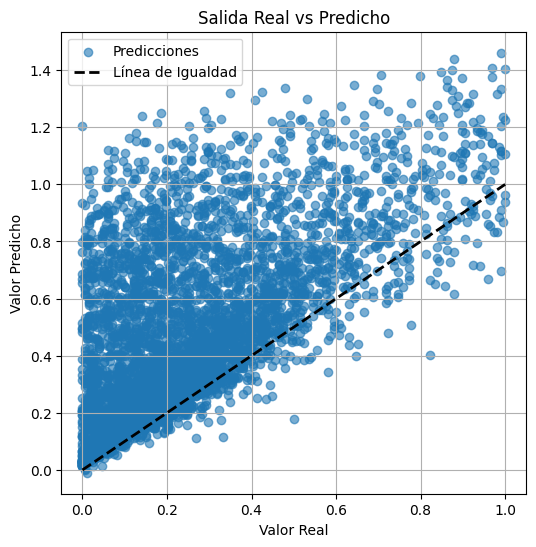

In [ ]:
# Obtener las predicciones del modelo
y_pred_list = []
y_real_list = []

# Iterar sobre val_dataset para extraer datos y hacer predicciones en lotes
for batch_x, batch_y in val_dataset:
    y_pred_batch = model_T.predict(batch_x)  # Predicción del modelo
    y_pred_list.append(y_pred_batch)
    y_real_list.append(batch_y.numpy())  # Convertir tensores a numpy

# Convertir listas a arrays
y_pred = np.concatenate(y_pred_list, axis=0)
y_real = np.concatenate(y_real_list, axis=0)

# Graficar predicciones vs valores reales
plt.figure(figsize=(6, 6))
plt.scatter(y_real[:, 0], y_pred[:, 0], alpha=0.6, label="Predicciones")
plt.plot([min(y_real[:, 0]), max(y_real[:, 0])],
         [min(y_real[:, 0]), max(y_real[:, 0])], 'k--', lw=2, label="Línea de Igualdad")  # Línea de referencia
plt.title('Salida Real vs Predicho')
plt.xlabel('Valor Real')
plt.ylabel('Valor Predicho')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
from sklearn.metrics import r2_score
import numpy as np

def masked_mape(y_true, y_pred, epsilon=1e-8):
    """ MAPE con enmascaramiento para valores cercanos a cero """
    mask = np.abs(y_true) > epsilon  # Evitar dividir por valores cercanos a 0
    return np.mean(np.abs((y_true[mask] - y_pred[mask]) / y_true[mask])) * 100

def smape(y_true, y_pred, epsilon=1e-8):
    """ SMAPE con enmascaramiento para valores cercanos a cero """
    denominator = np.abs(y_true) + np.abs(y_pred) + epsilon  # Evitar divisiones por 0
    return np.mean(2 * np.abs(y_true - y_pred) / denominator) * 100

# Calcular métricas por cada salida del modelo
for i in range(y_real.shape[1]):  # Si hay 2 salidas, se hace para cada una
    r2 = r2_score(y_real[:, i], y_pred[:, i])
    mape_value = masked_mape(y_real[:, i], y_pred[:, i])
    smape_value = smape(y_real[:, i], y_pred[:, i])

    print(f"\n📊 **Métricas para la Salida {i+1}**")
    print(f"✅ R² Score: {r2:.4f}")
    print(f"✅ MAPE: {mape_value:.2f}%")
    print(f"✅ SMAPE: {smape_value:.2f}%")


📊 **Métricas para la Salida 1**
✅ R² Score: -1.2353
✅ MAPE: 287.11%
✅ SMAPE: 67.29%


In [ ]:
import umap
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model

# Seleccionar capas específicas
layer_names = ['pool2_conv','conv3_block4_1_conv','conv4_block7_2_conv','conv5_block16_concat']  # Nombres según DenseNet121
selected_layers = [model_T.get_layer(name).output for name in layer_names]

# Crear modelos intermedios
intermediate_models = [Model(inputs=model_T.input, outputs=layer) for layer in selected_layers]
y_real_list = []
activations = {name: [] for name in layer_names}  # Diccionario para almacenar activaciones

# Extraer activaciones en lotes
for batch_x, batch_y in val_dataset:
    for name, model in zip(layer_names, intermediate_models):
        activations[name].append(model.predict(batch_x))  # Guardar salida
    y_real_list.append(batch_y.numpy())  # Guardar valores reales

# Convertir listas a arrays
y_real = np.concatenate(y_real_list, axis=0)
for name in layer_names:
    activations[name] = np.concatenate(activations[name], axis=0)


2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 64ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 5s 33ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 11s 41ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
2/2 ━━━━━━━

1/1 ━━━━━━━━━━━━━━━━━━━━ 11s 11s/step


In [ ]:
# #del val_dataset
# import gc

# # Lista de variables a eliminar manualmente
# del intermediate_models

# # Forzar recolección de basura
# gc.collect()

In [ ]:
del y_real_list

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


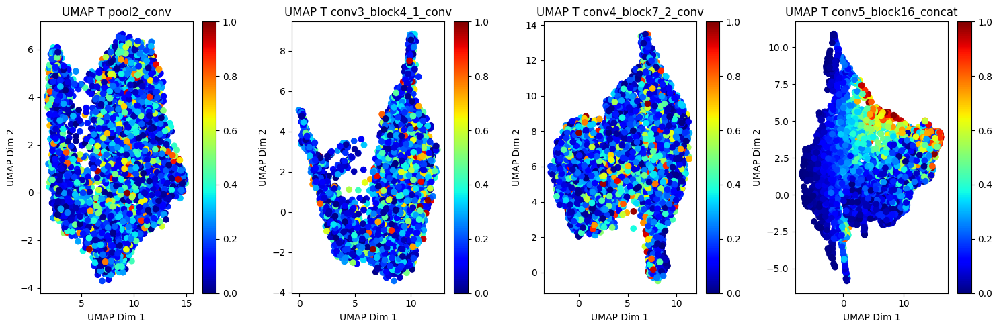

In [ ]:
reducer = umap.UMAP(
    n_components=2,
    n_neighbors=5,        # Menos vecinos = más rápido
    min_dist=0.5,         # Mayor separación en el espacio reducido
    metric='cosine',      # Puede ser más eficiente en datos de alta dimensión
    n_epochs=200,         # Reduce número de iteraciones
    low_memory=True
)

plt.figure(figsize=(15, 5))
for i, name in enumerate(layer_names):
    # Reducir dimensionalidad
    activation_2d = reducer.fit_transform(activations[name].reshape(activations[name].shape[0], -1))

    # Graficar
    plt.subplot(1, len(layer_names), i+1)
    plt.scatter(activation_2d[:, 0], activation_2d[:, 1], c=y_real[:, 0], cmap='jet')
    plt.colorbar()
    plt.title(f"UMAP T {name}")
    plt.xlabel("UMAP Dim 1")
    plt.ylabel("UMAP Dim 2")

plt.tight_layout()
# Guardar como SVG
plt.savefig("UMAP_visualization_T.svg", format="svg", dpi=300)
plt.show()